Обучить СНС с помощью Transfer Learning на датасете Food-101  
Использовать тонкую настройку существующей предобученной модели и методы аугментации данных.  
Библиотеки: [Python, Tensorflow]  

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import pandas as pd
import time

In [2]:
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [3]:

def time_matmul(x):
  start = time.time()
  for loop in range(100):
    tf.matmul(x, x)

  result = time.time()-start

  print("100 циклов: {:0.2f}ms".format(1000*result))

for i in range(2):
    # исполнение CPU
    print(" CPU работает:")
    with tf.device("CPU:0"):
      x = tf.random.uniform([1000, 1000])
      assert x.device.endswith("CPU:0")
      time_matmul(x)

    # исполнение на GPU #0 , если доступен
    if tf.config.experimental.list_physical_devices("GPU"):
      print("GPU работает:")
      with tf.device("GPU:0"): # или GPU:1 , для 2х GPU, GPU:2 для 3х  и т.д.
        x = tf.random.uniform([1000, 1000])
        assert x.device.endswith("GPU:0")
        time_matmul(x)

 CPU работает:
100 циклов: 352.32ms
GPU работает:
100 циклов: 342.88ms
 CPU работает:
100 циклов: 352.32ms
GPU работает:
100 циклов: 6.01ms


In [31]:
tfds.disable_progress_bar()
(train_ds, test_ds), ds_info = tfds.load(
    'food101', 
    as_supervised=True,
    with_info=True,
    split=['train[:90%]', 'train[90%:]'],
)

## информация о датасете

In [5]:
num_classes = ds_info.features['label'].num_classes
print(num_classes)

101


In [6]:
len(train_ds),len(test_ds)

(68175, 7575)

In [7]:
get_label_name = ds_info.features['label'].int2str
get_label_name(2)

'baklava'

In [8]:
some_samples = [x for x in iter(train_ds.take(32))]

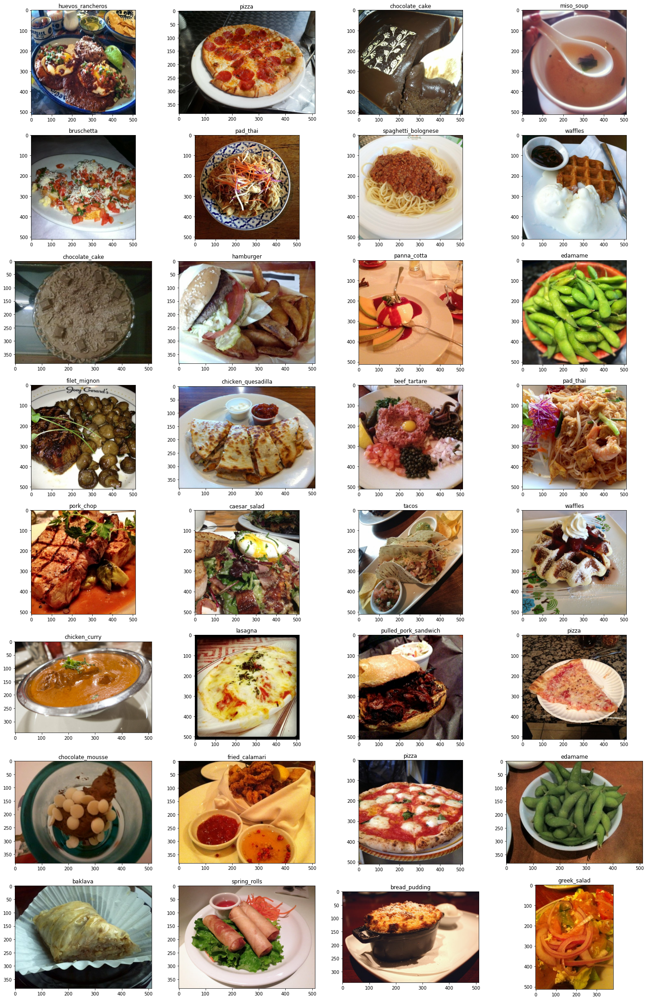

In [9]:
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

## Подготовка данных

In [10]:
def res(image, label):
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [11]:
def brightness_image (image, label):
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_brightness(image, 0.2, seed)
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label

In [12]:
def random_flip_up_down (image, label):
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_flip_up_down(image, seed)
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [13]:
def crop (image, label): 
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.resize(image, (224, 224))
    image = tf.image.stateless_random_crop(
          image, size=[224, 224, 3], seed=seed)
    
    image =tf.cast(image, tf.int32)
    return image , label

In [14]:
def flip(image, label): 
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_flip_left_right(
    image, seed)
    image = tf.image.resize(image, (224, 224))
    image = tf.cast(image, tf.int32)
    return image , label

In [15]:
def test_data_prepare(image, label): 
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [16]:
def test(patch,model):
    test_img = plt.imread(patch)
    print('Оригинал')
    plt.imshow(test_img)
    plt.show()
    img,_ = test_data_prepare(test_img,0)
    print('Подготовлденное')
    plt.imshow(img)
    plt.show()
    print('предсказания')
    pred = model(img[None, ...], training=False)
    pred_label = pred_label = np.argsort(pred.numpy()[0])[::-1]
    for i in pred_label[:5]:
        print('Prediction: {}'.format(ds_info.features['label'].int2str(i)))

In [32]:
ds_1 = train_ds.map(brightness_image)

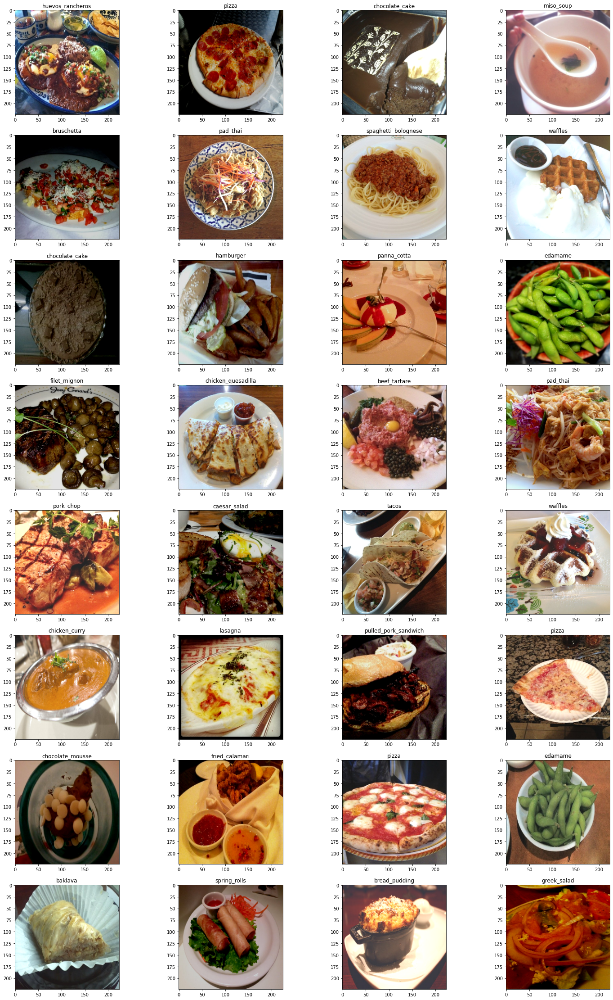

In [18]:
some_samples = [x for x in iter(ds_1.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

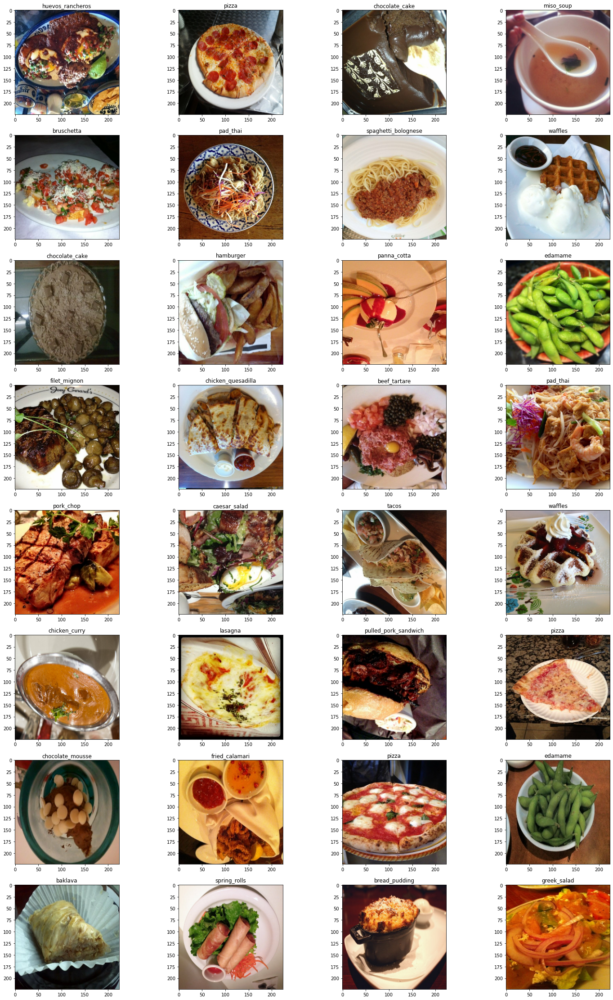

In [33]:
ds_2 = train_ds.map(random_flip_up_down)
some_samples = [x for x in iter(ds_2.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

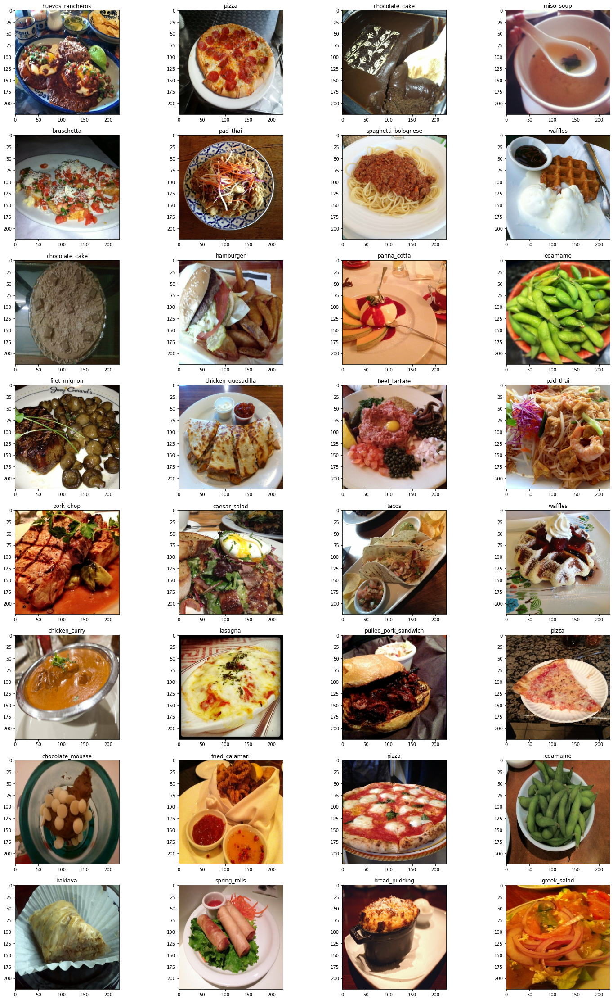

In [34]:
ds_3 = train_ds.map(crop)
some_samples = [x for x in iter(ds_3.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

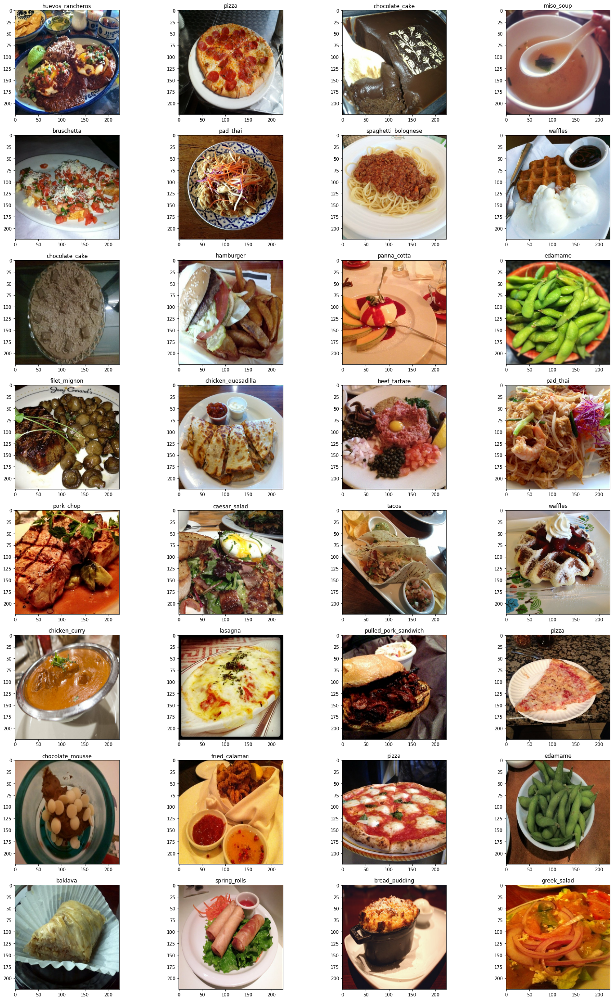

In [35]:
ds_4 = train_ds.map(flip)
some_samples = [x for x in iter(ds_4.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

In [36]:
train_ds = train_ds.map(res)

In [37]:
train_ds = train_ds.concatenate(ds_1)
train_ds = train_ds.concatenate(ds_2)
train_ds = train_ds.concatenate(ds_3)
train_ds = train_ds.concatenate(ds_4)

In [38]:
len(train_ds)

340875

In [39]:
# INP_SIZE = 160
# NUM_EPOCHS = 10
BATCH_SIZE = 32
AUTOTUNE = tf.data.AUTOTUNE


train_ds = train_ds.shuffle(buffer_size=10000)
train_ds = train_ds.batch(BATCH_SIZE, drop_remainder=True)
train_ds.prefetch(buffer_size=AUTOTUNE)

test_ds = test_ds.shuffle(buffer_size=5000)
test_ds = test_ds.map(test_data_prepare,num_parallel_calls=AUTOTUNE)
test_ds = test_ds.batch(128, drop_remainder=True)
test_ds.prefetch(buffer_size=AUTOTUNE)


<PrefetchDataset shapes: ((128, 224, 224, 3), (128,)), types: (tf.int32, tf.int64)>

# Подготовка модели CNN

### Обучаем все слои

In [40]:
base_model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        include_top=False,
        weights='imagenet'
    )
base_model.trainable = True 

In [41]:
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalMaxPooling2D(),
    tf.keras.layers.Dense(101, activation='softmax'),
])


In [42]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_max_pooling2d_1 (Glob (None, 1280)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 101)               129381    
Total params: 4,355,813
Trainable params: 4,331,413
Non-trainable params: 24,400
_________________________________________________________________


In [48]:
LEARNING_RATE = 0.0001
optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE)
# optimizer = tf.keras.optimizers.RMSprop(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])



In [49]:
%%time
history = model.fit(
    train_ds,
    epochs=1,
    validation_data=test_ds)

10652/10652 [==============================] - 2942s 275ms/step - loss: 0.0721 - accuracy: 0.9793 - val_loss: 1.3766 - val_accuracy: 0.7883
Wall time: 49min 2s


In [50]:
%%time
model.evaluate(test_ds)

59/59 [==============================] - 11s 170ms/step - loss: 1.3762 - accuracy: 0.7881
Wall time: 10.9 s


[1.376192569732666, 0.7881355881690979]

Оригинал


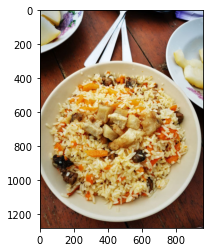

Подготовлденное


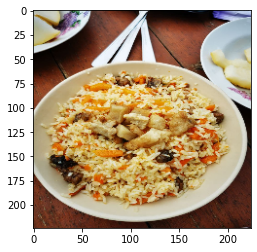

предсказания
Prediction: fried_rice
Prediction: paella
Prediction: risotto
Prediction: carrot_cake
Prediction: dumplings


In [51]:
test('photo_2021-09-08_03-45-04.jpg',model)

Оригинал


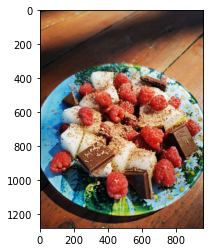

Подготовлденное


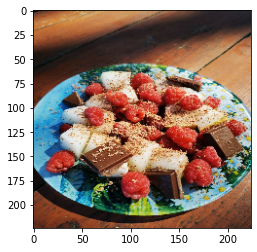

предсказания
Prediction: waffles
Prediction: strawberry_shortcake
Prediction: baklava
Prediction: chocolate_mousse
Prediction: chocolate_cake


In [52]:
test('1.jpg',model)

Оригинал


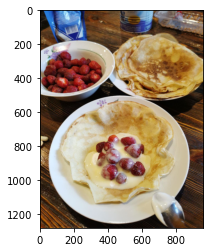

Подготовлденное


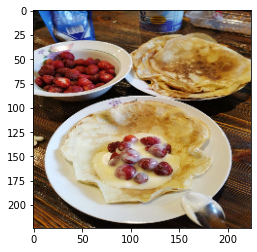

предсказания
Prediction: pancakes
Prediction: huevos_rancheros
Prediction: breakfast_burrito
Prediction: omelette
Prediction: eggs_benedict


In [53]:
test('2.jpg',model)

Оригинал


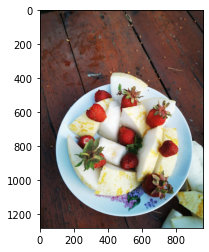

Подготовлденное


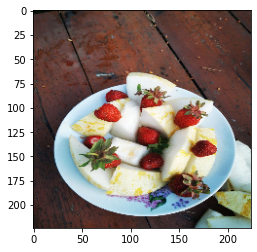

предсказания
Prediction: caesar_salad
Prediction: omelette
Prediction: beef_carpaccio
Prediction: deviled_eggs
Prediction: scallops


In [54]:
test('3.jpg',model)

Оригинал


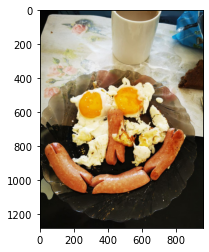

Подготовлденное


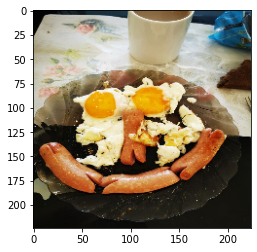

предсказания
Prediction: croque_madame
Prediction: waffles
Prediction: hot_dog
Prediction: huevos_rancheros
Prediction: greek_salad


In [55]:
test('4.jpg',model)

Оригинал


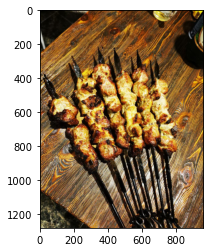

Подготовлденное


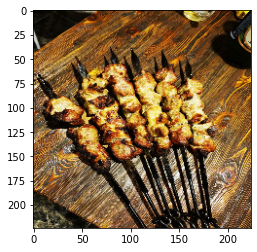

предсказания
Prediction: grilled_salmon
Prediction: baklava
Prediction: chicken_wings
Prediction: takoyaki
Prediction: gnocchi


In [56]:
test('5.jpg',model)

### Обучаем последний слой

In [57]:
base_model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        include_top=False,
        weights='imagenet'
    )
base_model.trainable = False


In [58]:
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalMaxPooling2D(),
    tf.keras.layers.Dense(101, activation='softmax'),
])


In [59]:
model.compile(optimizer='Adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_max_pooling2d_2 (Glob (None, 1280)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 101)               129381    
Total params: 4,355,813
Trainable params: 129,381
Non-trainable params: 4,226,432
_________________________________________________________________


In [63]:
%%time
history = model.fit(
    train_ds,
    epochs=1,
    validation_data=test_ds)

10652/10652 [==============================] - 1043s 98ms/step - loss: 0.8427 - accuracy: 0.7668 - val_loss: 1.6189 - val_accuracy: 0.6274
Wall time: 17min 23s


In [64]:
%%time
model.evaluate(test_ds)

59/59 [==============================] - 11s 171ms/step - loss: 1.6189 - accuracy: 0.6273
Wall time: 11 s


[1.6188660860061646, 0.6272510886192322]

Оригинал


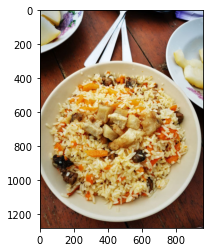

Подготовлденное


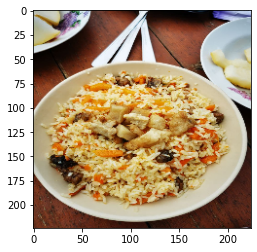

предсказания
Prediction: fried_rice
Prediction: hummus
Prediction: macaroni_and_cheese
Prediction: huevos_rancheros
Prediction: paella
Оригинал


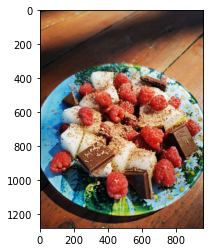

Подготовлденное


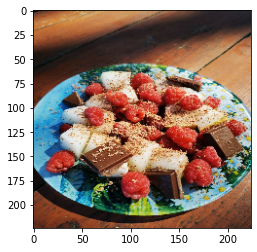

предсказания
Prediction: strawberry_shortcake
Prediction: bruschetta
Prediction: takoyaki
Prediction: beet_salad
Prediction: foie_gras
Оригинал


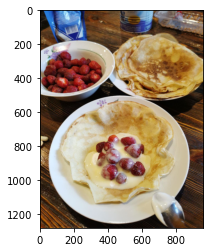

Подготовлденное


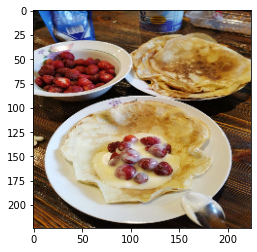

предсказания
Prediction: pancakes
Prediction: hummus
Prediction: bread_pudding
Prediction: omelette
Prediction: huevos_rancheros
Оригинал


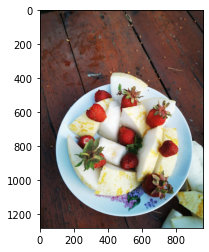

Подготовлденное


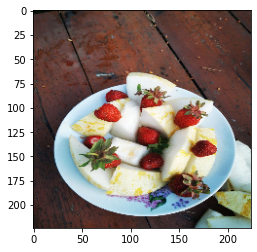

предсказания
Prediction: carrot_cake
Prediction: strawberry_shortcake
Prediction: chocolate_mousse
Prediction: beef_carpaccio
Prediction: cheesecake
Оригинал


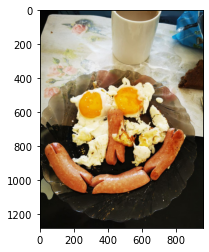

Подготовлденное


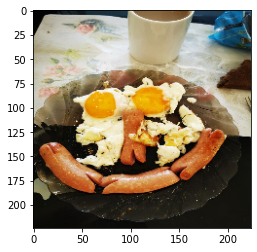

предсказания
Prediction: waffles
Prediction: sushi
Prediction: lobster_roll_sandwich
Prediction: bruschetta
Prediction: huevos_rancheros
Оригинал


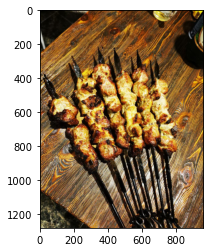

Подготовлденное


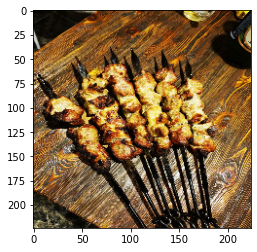

предсказания
Prediction: steak
Prediction: churros
Prediction: garlic_bread
Prediction: chocolate_cake
Prediction: takoyaki


In [65]:
test('photo_2021-09-08_03-45-04.jpg',model)
test('1.jpg',model)
test('2.jpg',model)
test('3.jpg',model)
test('4.jpg',model)
test('5.jpg',model)